# 'Exploratory Data Analysis Project on Global Terrorism Activities'



**Global Terrorism**-


**Terrorism** is the unlawful use of force or violence against persons or property to intimidate or coerce a government or its citizens to further certain political or social objectives. 

Terrorism has been described as:

- The use of violence or of the threat of violence in the pursuit of political, religious, ideological or social objectives.

- Acts committed by non-state actors (or by undercover personnel serving on the behalf of their respective governments)

- Acts reaching more than the immediate target victims and also directed at targets consisting of a larger spectrum of society.

The following criteria of violence or threat of violence usually fall outside of the definition of terrorism:

- Wartime (including a declared war) or peacetime acts of violence committed by a nation state against another nation state regardless of legality or illegality and are carried out by properly uniformed forces or legal combatants of such nation states.

- Reasonable acts of self-defense, such as the use of force to kill, apprehend, or punish criminals who pose a threat to the lives of humans or property.

- Legitimate targets in war, such as enemy combatants and strategic infrastructure that form an integral part of the enemy's war effort such as defense industries and ports.

- Collateral damage, including the infliction of incidental damage to non-combatant targets during an attack on or attempting to attack legitimate targets in war.




### Project Outlook -
 
 > We will be covering up this project under the 5 Steps-
 -  **Selecting a real-world dataset**
 - **Performing Data Cleaning and Structuring For Analysis**
 - **Performing Data Analysis With Graphical Visualization**
 - **Asking and Answering Question about the Dataset**
 - **Sumarizing the Insights gathered from the dataset and Conclusions**

## Selecting a Real- World Dataset
 - In this project we are using the **"GLOBAL TERRORISM DATASET"** downloaded from the one of the most popular Opensource Dataset Platform [Kaggle](https://www.kaggle.com/datasets/START-UMD/gtd).
 
 
 > **About DataSet** - The dataset contains aprrox **180k** of Terrorist activity reported under the time frame of 47 years that is from **1970** till **2017**. 
The dataset have **135** different informative parameters under which an activity has been reported.
These are -
**DATE**,**COUNTRY**,**STATE**,**REGION**,**Number of people KILLED**,**TERRORIST GROUP responsible for the attack**,**Attack Types** etc.

- Now let's first Import required libaries and download the dataset and write it into a directory.

### Importing required Libarries

In [ ]:
!pip install jovian --upgrade --quiet

In [ ]:
import jovian

In [ ]:
# Execute this to save new versions of the notebook
jovian.commit(project="exploratory-data-analysis-Project-EDA")

<IPython.core.display.Javascript object>

[jovian] Updating notebook "singh-pankaj0018/exploratory-data-analysis-project-eda" on https://jovian.com


In [2]:
!pip install pyyaml==5.4.1
!pip install pandas-profiling matplotlib seaborn plotly folium opendatasets wordcloud --quiet --upgrade
%matplotlib inline

     |████████████████████████████████| 630 kB 6.6 MB/s            
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0


In [3]:
import plotly.express as px
import plotly.figure_factory as ff
import numpy as np
import pandas as pd
import opendatasets as od
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
%matplotlib inline

### Downloading Dataset with the **OpenDataset** Library


In [5]:
link="https://www.kaggle.com/START-UMD/gtd"

In [6]:
od.download(link)

Skipping, found downloaded files in "./gtd" (use force=True to force download)


**Writing the downloaded dataset into the directory**

In [7]:
data_dir='./gtd/globalterrorismdb_0718dist.csv'

## Data Cleaning and Structuring 

- First we will be Loading the data using ""**Pandas**"" library.
- Second we will be exploring the given information such as shape, range, number of rows and columns of the dataset. 
- Third we will fix the missing values and the duplicate data from the dataset and then create a copy of the new Dataset **Data** that will be ready for the use for the ANALYSIS.



In [8]:
#Loading the downloaded dataset from the directory into a dataframe using the Pandas "pd.read_csv" function.
DF=pd.read_csv(data_dir,encoding='ISO-8859-1',low_memory=False)

In [9]:
DF.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


### Exploring the Dataset size, range,number of columns and other attributes

In [10]:
# DF is the datafrane that has been created with the loaded dataset.
# DF.shape function indicates the total number of rows & Columns.
DF.shape

(181691, 135)

In [11]:
# DataFrame ".coulmn" function gives us the total columns names that are present within the dataset.
DF.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

In [12]:
list(DF.columns)

['eventid',
 'iyear',
 'imonth',
 'iday',
 'approxdate',
 'extended',
 'resolution',
 'country',
 'country_txt',
 'region',
 'region_txt',
 'provstate',
 'city',
 'latitude',
 'longitude',
 'specificity',
 'vicinity',
 'location',
 'summary',
 'crit1',
 'crit2',
 'crit3',
 'doubtterr',
 'alternative',
 'alternative_txt',
 'multiple',
 'success',
 'suicide',
 'attacktype1',
 'attacktype1_txt',
 'attacktype2',
 'attacktype2_txt',
 'attacktype3',
 'attacktype3_txt',
 'targtype1',
 'targtype1_txt',
 'targsubtype1',
 'targsubtype1_txt',
 'corp1',
 'target1',
 'natlty1',
 'natlty1_txt',
 'targtype2',
 'targtype2_txt',
 'targsubtype2',
 'targsubtype2_txt',
 'corp2',
 'target2',
 'natlty2',
 'natlty2_txt',
 'targtype3',
 'targtype3_txt',
 'targsubtype3',
 'targsubtype3_txt',
 'corp3',
 'target3',
 'natlty3',
 'natlty3_txt',
 'gname',
 'gsubname',
 'gname2',
 'gsubname2',
 'gname3',
 'gsubname3',
 'motive',
 'guncertain1',
 'guncertain2',
 'guncertain3',
 'individual',
 'nperps',
 'nperpcap',
 

In [13]:
pd.set_option('max_columns', None)

In [14]:
DF.head(10)

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,region_txt,provstate,city,latitude,longitude,specificity,vicinity,location,summary,crit1,crit2,crit3,doubtterr,alternative,alternative_txt,multiple,success,suicide,attacktype1,attacktype1_txt,attacktype2,attacktype2_txt,attacktype3,attacktype3_txt,targtype1,targtype1_txt,targsubtype1,targsubtype1_txt,corp1,target1,natlty1,natlty1_txt,targtype2,targtype2_txt,targsubtype2,targsubtype2_txt,corp2,target2,natlty2,natlty2_txt,targtype3,targtype3_txt,targsubtype3,targsubtype3_txt,corp3,target3,natlty3,natlty3_txt,gname,gsubname,gname2,gsubname2,gname3,gsubname3,motive,guncertain1,guncertain2,guncertain3,individual,nperps,nperpcap,claimed,claimmode,claimmode_txt,claim2,claimmode2,claimmode2_txt,claim3,claimmode3,claimmode3_txt,compclaim,weaptype1,weaptype1_txt,weapsubtype1,weapsubtype1_txt,weaptype2,weaptype2_txt,weapsubtype2,weapsubtype2_txt,weaptype3,weaptype3_txt,weapsubtype3,weapsubtype3_txt,weaptype4,weaptype4_txt,weapsubtype4,weapsubtype4_txt,weapdetail,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,propextent,propextent_txt,propvalue,propcomment,ishostkid,nhostkid,nhostkidus,nhours,ndays,divert,kidhijcountry,ransom,ransomamt,ransomamtus,ransompaid,ransompaidus,ransomnote,hostkidoutcome,hostkidoutcome_txt,nreleased,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,Central America & Caribbean,NaN,Santo Domingo,18.456792,-69.951164,1.0,0,NaN,NaN,1,1,1,0.0,NaN,NaN,0.0,1,0,1,Assassination,NaN,NaN,NaN,NaN,14,Private Citizens & Property,68.0,Named Civilian,NaN,Julio Guzman,58.0,Dominican Republic,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,MANO-D,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,North America,Federal,Mexico city,19.371887,-99.086624,1.0,0,NaN,NaN,1,1,1,0.0,NaN,NaN,0.0,1,0,6,Hostage Taking (Kidnapping),NaN,NaN,NaN,NaN,7,Government (Diplomatic),45.0,"Diplomatic Personnel (outside of embassy, cons...",Belgian Ambassador Daughter,"Nadine Chaval, daughter",21.0,Belgium,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23rd of September Communist League,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,1.0,1.0,0.0,NaN,NaN,NaN,Mexico,1.0,800000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,Southeast Asia,Tarlac,Unknown,15.478598,120.599741,4.0,0,NaN,NaN,1,1,1,0.0,NaN,NaN,0.0,1,0,1,Assassination,NaN,NaN,NaN,NaN,10,Journalists & Media,54.0,Radio Journalist/Staff/Facility,Voice of America,Employee,217.0,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,Western Europe,Attica,Athens,37.997490,23.762728,1.0,0,NaN,NaN,1,1,1,0.0,NaN,NaN,0.0,1,0,3,Bombing/Explosion,NaN,NaN,NaN,NaN,7,Government (Diplomatic),46.0,Embassy/Consulate,NaN,U.S. Embassy,217.0,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6,Explosives,16.0,Unknown Explosive Type,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Explosive,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN

In [15]:
# DataFrame ".describe" method returns description of the data in the DataFrame.

# If the DataFrame contains numerical data, the description contains these information for each column:
# count - The number of not-empty values.
# mean - The average (mean) value.
# std - The standard deviation.
# min - the minimum value.
# 25% - The 25% percentile*.
# 50% - The 50% percentile*.
# 75% - The 75% percentile*.
# max - the maximum value.
# Percentile meaning: how many of the values are less than the given percentile.

DF.describe()

,eventid,iyear,imonth,iday,extended,country,region,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,doubtterr,alternative,multiple,success,suicide,attacktype1,attacktype2,attacktype3,targtype1,targsubtype1,natlty1,targtype2,targsubtype2,natlty2,targtype3,targsubtype3,natlty3,guncertain1,guncertain2,guncertain3,individual,nperps,nperpcap,claimed,claimmode,claim2,claimmode2,claim3,claimmode3,compclaim,weaptype1,weapsubtype1,weaptype2,weapsubtype2,weaptype3,weapsubtype3,weaptype4,weapsubtype4,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,propextent,propvalue,ishostkid,nhostkid,nhostkidus,nhours,ndays,ransom,ransomamt,ransomamtus,ransompaid,ransompaidus,hostkidoutcome,nreleased,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
count,1.816910e+05,181691.000000,181691.000000,181691.000000,181691.000000,181691.000000,181691.000000,177135.000000,1.771340e+05,181685.000000,181691.000000,181691.000000,181691.000000,181691.000000,181690.000000,29011.000000,181690.000000,181691.000000,181691.000000,181691.000000,6314.000000,428.000000,181691.000000,171318.000000,180132.000000,11144.000000,10685.000000,10828.000000,1176.000000,1097.000000,1147.000000,181311.000000,1955.000000,320.000000,181691.000000,110576.000000,112202.000000,115571.000000,19083.000000,1890.000000,616.000000,318.000000,133.000000,4839.000000,181691.000000,160923.000000,13127.000000,11542.000000,1863.000000,1693.000000,73.000000,70.000000,171378.000000,117245.000000,114733.000000,165380.000000,116989.000000,112548.000000,181691.000000,64065.000000,3.898900e+04,181513.000000,13572.000000,13517.000000,4063.000000,8124.000000,77381.000000,1.350000e+03,5.630000e+02,7.740000e+02,552.000000,10991.000000,10400.000000,181691.000000,181691.000000,181691.000000,181691.000000
mean,2.002705e+11,2002.638997,6.467277,15.505644,0.045346,131.968501,7.160938,23.498343,-4.586957e+02,1.451452,0.068297,0.988530,0.993093,0.875668,-0.523171,1.292923,0.137773,0.889598,0.036507,3.247547,3.719512,5.245327,8.439719,46.971474,127.686441,10.247218,55.311652,131.179442,10.021259,55.548769,144.564952,0.081440,0.265473,0.193750,0.002950,-65.361154,-1.517727,0.049666,7.022848,0.247619,7.176948,0.411950,6.729323,-6.296342,6.447325,11.117162,6.812524,10.754029,6.911433,11.643237,6.246575,10.842857,2.403272,0.045981,0.508058,3.167668,0.038944,0.107163,-0.544556,3.295403,2.088119e+05,0.059054,4.533230,-0.353999,-46.793933,-32.516371,-0.145811,3.172530e+06,5.784865e+05,7.179437e+05,240.378623,4.629242,-29.018269,-4.543731,-4.464398,0.090010,-3.945952
std,1.325957e+09,13.259430,3.388303,8.814045,0.208063,112.414535,2.933408,18.569242,2.047790e+05,0.995430,0.284553,0.106483,0.082823,0.329961,2.455819,0.703729,0.344663,0.313391,0.187549,1.915772,2.272023,2.246642,6.653838,30.953357,89.299120,5.709076,25.640310,125.951485,5.723447,26.288955,163.299295,0.273511,0.441698,0.395854,0.054234,216.536633,12.830346,1.093195,2.476851,0.974018,2.783725,0.492962,2.908003,4.234620,2.173435,6.495612,2.277081,7.594574,2.177956,8.493166,1.507212,8.192672,11.545741,5.681854,4.199937,35.949392,3.057361,1.488881,3.122889,0.486912,1.552463e+07,0.461244,202.316386,6.835645,82.800405,121.209205,1.207861,3.021157e+07,7.077924e+06,1.014392e+07,2940.967293,2.035360,65.720119,4.543547,4.637152,0.568457,4.691325
min,1.970000e+11,1970.000000,0.000000,0.000000,0.000000,4.000000,1.000000,-53.154613,-8.618590e+07,1.000000,-9.000000,0.000000,0.000000,0.000000,-9.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,4.000000,1.000000,1.000000,4.000000,1.000000,1.000000,4.000000,0.000000,0.000000,0.000000,0.000000,-99.000000,-99.000000,-9.000000,1.000000,-9.000000,1.000000,0.000000,1.000000,-9.000000,1.000000,1.000000,1.000000,1.000000,2.000000,1.000000,5.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-9.000000,1.000000,-9.900000e+01,-9.000000,-99.000000,-99.000000,-99.000000,-99.000000,-9.000000,-9.900000e+01,-9.900000e+01,-9.900000e+01,-99.000000,1.000000,-99.000000,-9.000000,-9.000

In [16]:
# DataFrame ".info" function gives the compact information about the dataset.
# The information contains the number of columns, column labels, column data types, memory usage, range index, and the number of cells in each column (non-null values).
DF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


### Data Structuring 

**Let's First Rename the Coulmns so as to be able to identify the data related to each coulmns.**

In [17]:
DF.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

In [18]:
DF.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day', 'country_txt':'Country','provstate':'State',
                         'region_txt':'Region','attacktype1_txt':'Attack_Type','target1':'Target','nkill':'Killed',
                       'nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type',
                       'weaptype1_txt':'Weapon_type','motive':'Motive','location':'Location','latitude':'Latitude','longitude':'Longitude'},inplace=True)

**Let's generate a new DataFrame with the above renamed columns for our analysis based only on the selected Columns/Features**

In [19]:
df=DF[['Year','Month','Day','Country','State','Region','Attack_Type','Target','Killed','Wounded','Summary','Group','Target_type',
       'Weapon_type','Motive','Location','Longitude','Latitude']]

In [20]:
df

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
0,1970,7,2,Dominican Republic,NaN,Central America & Caribbean,Assassination,Julio Guzman,1.0,0.0,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,NaN,-69.951164,18.456792
1,1970,0,0,Mexico,Federal,North America,Hostage Taking (Kidnapping),"Nadine Chaval, daughter",0.0,0.0,NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,NaN,-99.086624,19.371887
2,1970,1,0,Philippines,Tarlac,Southeast Asia,Assassination,Employee,1.0,0.0,NaN,Unknown,Journalists & Media,Unknown,NaN,NaN,120.599741,15.478598
3,1970,1,0,Greece,Attica,Western Europe,Bombing/Explosion,U.S. Embassy,NaN,NaN,NaN,Unknown,Government (Diplomatic),Explosives,NaN,NaN,23.762728,37.997490
4,1970,1,0,Japan,Fukouka,East Asia,Facility/Infrastructure Attack,U.S. Consulate,NaN,NaN,NaN,Unknown,Government (Diplomatic),Incendiary,NaN,NaN,130.396361,33.580412
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181686,2017,12,31,Somalia,Middle Shebelle,Sub-Saharan Africa,Armed Assault,Checkpoint,1.0,2.0,12/31/2017: Assailants opened fire on a Somali...,Al-Shabaab,Military,Firearms,NaN,The incident occurred near the town of Balcad.,45.385034,2.359673
181687,2017,12,31,Syria,Lattakia,Middle East & North Africa,Bombing/Explosion,Hmeymim Air Base,2.0,7.0,12/31/2017: Assailants launched mortars at the...,Muslim extremists,Military,Explosives,NaN,The incident occurred at the Humaymim Airport.,35.942679,35.407278
181688,2017,12,31,Philippines,Maguindanao,Southeast Asia,Facility/Infrastructure Attack,Houses,0.0,0.0,12/31/2017: Assailants set fire to houses in K...,Bangsamoro Islamic Freedom Movement (BIFM),Private Citizens & Property,Incendiary,NaN,The incident occurred in the Datu Hoffer distr...,124.437908,6.900742
181689,2017,12,31,India,Manipur,South Asia,Bombing/Explosion,Office,0.0,0.0,12/31/2017: Assailants threw a grenade at a Fo...,Unknown,Government (General),Explosives,NaN,The incident occurred in the Mantripukhri neig...,93.940430,24.798346


**Let's first create a copy of the dataframe and then locate the numbers for the missing data in our dataset.**

In [21]:
main_df=df.copy()

In [22]:
main_df.head(5)

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
0,1970,7,2,Dominican Republic,NaN,Central America & Caribbean,Assassination,Julio Guzman,1.0,0.0,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,NaN,-69.951164,18.456792
1,1970,0,0,Mexico,Federal,North America,Hostage Taking (Kidnapping),"Nadine Chaval, daughter",0.0,0.0,NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,NaN,-99.086624,19.371887
2,1970,1,0,Philippines,Tarlac,Southeast Asia,Assassination,Employee,1.0,0.0,NaN,Unknown,Journalists & Media,Unknown,NaN,NaN,120.599741,15.478598
3,1970,1,0,Greece,Attica,Western Europe,Bombing/Explosion,U.S. Embassy,NaN,NaN,NaN,Unknown,Government (Diplomatic),Explosives,NaN,NaN,23.762728,37.997490
4,1970,1,0,Japan,Fukouka,East Asia,Facility/Infrastructure Attack,U.S. Consulate,NaN,NaN,NaN,Unknown,Government (Diplomatic),Incendiary,NaN,NaN,130.396361,33.580412


In the above DataFrame we can see there is a column for Day and Month at which the incident happened and it filled with the "0" which is not possible, we will be cleaning the incorrect data for the dates and months later on this notebook.


### Data Cleaning 

In [23]:
main_df.isna().sum()

Year                0
Month               0
Day                 0
Country             0
State             421
Region              0
Attack_Type         0
Target            636
Killed          10313
Wounded         16311
Summary         66129
Group               0
Target_type         0
Weapon_type         0
Motive         131130
Location       126196
Longitude        4557
Latitude         4556
dtype: int64

Here we can clearly see the State has 421 missing values, Target has 636, killed has 10313 and so on.
- Here we can Fill the missing data with the Mean/Median/Mode Value.
- Ignore the missing data and do the analysis without that particular data/Column in such a way that it does not effect the analysis 

**Let's fill the missing places for the state column as "Unknown".**

In [24]:
main_df.State.fillna("Unknown", inplace = True) 

In [25]:
main_df["State"].isna().sum()

0

**Filling Missing values for Targets as "Unknown".**

In [26]:
main_df.Target.fillna("Unknown", inplace = True)

In [27]:
main_df.Target.isna().sum()

0

In [28]:
main_df.Killed

0         1.0
1         0.0
2         1.0
3         NaN
4         NaN
         ... 
181686    1.0
181687    2.0
181688    0.0
181689    0.0
181690    0.0
Name: Killed, Length: 181691, dtype: float64

 **Here there are some NAN values on the killed Column, let's find out the Mean, Median and Mode for the Column**

In [29]:
main_df.Killed.mean()

2.4032722986614385

In [30]:
main_df['Killed'].mode()

0    0.0
dtype: float64

**Here we are filling up the empty/missing(NAN) values in the column with the mode value that is 0.**

In [31]:
main_df.Killed.fillna(df.Killed.mode()[0],inplace = True)

In [32]:
main_df["Killed"]

0         1.0
1         0.0
2         1.0
3         0.0
4         0.0
         ... 
181686    1.0
181687    2.0
181688    0.0
181689    0.0
181690    0.0
Name: Killed, Length: 181691, dtype: float64

In [33]:
main_df.Killed.isna().sum()

0

**Filling up the Wounded column with the mode value.**

In [34]:
main_df.Wounded.fillna(df.Wounded.mode()[0], inplace = True)

In [35]:
main_df['Wounded'].isna().sum()

0

In [36]:
main_df.Wounded.value_counts()

0.0      119586
1.0       16033
2.0       10219
3.0        7303
4.0        4880
          ...  
727.0         1
216.0         1
751.0         1
233.0         1
316.0         1
Name: Wounded, Length: 238, dtype: int64

**Let's now check for the duplicate data in the our main DataFrame.** 

In [37]:
main_df.duplicated().value_counts()

False    172157
True       9534
dtype: int64

- The above **True** values refers to duplicate data in the dataset and we should always remove/drop the duplicate values.


In [38]:
DF1=main_df.drop_duplicates()

In [39]:
DF1

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
0,1970,7,2,Dominican Republic,Unknown,Central America & Caribbean,Assassination,Julio Guzman,1.0,0.0,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,NaN,-69.951164,18.456792
1,1970,0,0,Mexico,Federal,North America,Hostage Taking (Kidnapping),"Nadine Chaval, daughter",0.0,0.0,NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,NaN,-99.086624,19.371887
2,1970,1,0,Philippines,Tarlac,Southeast Asia,Assassination,Employee,1.0,0.0,NaN,Unknown,Journalists & Media,Unknown,NaN,NaN,120.599741,15.478598
3,1970,1,0,Greece,Attica,Western Europe,Bombing/Explosion,U.S. Embassy,0.0,0.0,NaN,Unknown,Government (Diplomatic),Explosives,NaN,NaN,23.762728,37.997490
4,1970,1,0,Japan,Fukouka,East Asia,Facility/Infrastructure Attack,U.S. Consulate,0.0,0.0,NaN,Unknown,Government (Diplomatic),Incendiary,NaN,NaN,130.396361,33.580412
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181686,2017,12,31,Somalia,Middle Shebelle,Sub-Saharan Africa,Armed Assault,Checkpoint,1.0,2.0,12/31/2017: Assailants opened fire on a Somali...,Al-Shabaab,Military,Firearms,NaN,The incident occurred near the town of Balcad.,45.385034,2.359673
181687,2017,12,31,Syria,Lattakia,Middle East & North Africa,Bombing/Explosion,Hmeymim Air Base,2.0,7.0,12/31/2017: Assailants launched mortars at the...,Muslim extremists,Military,Explosives,NaN,The incident occurred at the Humaymim Airport.,35.942679,35.407278
181688,2017,12,31,Philippines,Maguindanao,Southeast Asia,Facility/Infrastructure Attack,Houses,0.0,0.0,12/31/2017: Assailants set fire to houses in K...,Bangsamoro Islamic Freedom Movement (BIFM),Private Citizens & Property,Incendiary,NaN,The incident occurred in the Datu Hoffer distr...,124.437908,6.900742
181689,2017,12,31,India,Manipur,South Asia,Bombing/Explosion,Office,0.0,0.0,12/31/2017: Assailants threw a grenade at a Fo...,Unknown,Government (General),Explosives,NaN,The incident occurred in the Mantripukhri neig...,93.940430,24.798346


**On dropping the Duplicate values we can clearly see the reduction in the number of rows that is from 181691 to 172092**
 
 

In [40]:
DF1.shape

(172157, 18)

In [41]:
DF1.isna().sum()

Year                0
Month               0
Day                 0
Country             0
State               0
Region              0
Attack_Type         0
Target              0
Killed              0
Wounded             0
Summary         59002
Group               0
Target_type         0
Weapon_type         0
Motive         122233
Location       117204
Longitude        3971
Latitude         3970
dtype: int64

**Let now remove the data which have Date and Month as "0".**

In [42]:
DF1[DF1["Month"]==0]

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
1,1970,0,0,Mexico,Federal,North America,Hostage Taking (Kidnapping),"Nadine Chaval, daughter",0.0,0.0,NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,NaN,-99.086624,19.371887
1123,1972,0,0,Philippines,Capiz,Southeast Asia,Bombing/Explosion,air manila fokker F-27p,0.0,0.0,NaN,Unknown,Airports & Aircraft,Explosives,NaN,NaN,122.753716,11.586558
1690,1973,0,0,Colombia,Unknown,South America,Hostage Taking (Kidnapping),"Alirio Serrano Sanchez, rancher",0.0,0.0,NaN,National Liberation Army of Colombia (ELN),Business,Unknown,NaN,NaN,NaN,NaN
2164,1974,0,0,France,Paris,Western Europe,Bombing/Explosion,Bank Lazard,0.0,0.0,NaN,Unknown,Business,Explosives,NaN,NaN,2.342330,48.856644
2165,1974,0,0,Italy,Lazio,Western Europe,Bombing/Explosion,TWA Boeing 707,0.0,0.0,NaN,Unknown,Airports & Aircraft,Explosives,NaN,NaN,12.490069,41.890961
2744,1975,0,0,Pakistan,Punjab,South Asia,Bombing/Explosion,Pakistan Airlines Boeing 707,0.0,0.0,NaN,Unknown,Airports & Aircraft,Explosives,NaN,NaN,73.069077,33.594013
3484,1976,0,0,Turkey,Istanbul,Middle East & North Africa,Unknown,Turkish Army Vehicle,0.0,0.0,NaN,Armenian Secret Army for the Liberation of Arm...,Military,Unknown,NaN,NaN,28.689863,41.106178
3485,1976,0,0,Turkey,Ankara,Middle East & North Africa,Unknown,military base,0.0,0.0,NaN,Armenian Secret Army for the Liberation of Arm...,Military,Unknown,NaN,NaN,32.767540,39.930771
4407,1977,0,0,Japan,Tokyo,East Asia,Bombing/Explosion,Tokyo University,0.0,0.0,NaN,Tribal Battlefront,Educational Institution,Explosives,NaN,NaN,139.747742,35.689125
4408,1977,0,0,Japan,Tokyo,East Asia,Bombing/Explosion,Private Residence of President of a leading al...,0.0,0.0,NaN,Tribal Battlefront,Business,Explosives,NaN,NaN,139.747742,35.689125


In [43]:
DF1[DF1.Month==0].shape

(20, 18)

**Here we can see that there are total 20 rows of data that has the value "0" for the month, let's check for the Day column as well and then drop data for both the coulmns.**

In [44]:
DF1[DF1.Day==0]

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
1,1970,0,0,Mexico,Federal,North America,Hostage Taking (Kidnapping),"Nadine Chaval, daughter",0.0,0.0,NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,NaN,-99.086624,19.371887
2,1970,1,0,Philippines,Tarlac,Southeast Asia,Assassination,Employee,1.0,0.0,NaN,Unknown,Journalists & Media,Unknown,NaN,NaN,120.599741,15.478598
3,1970,1,0,Greece,Attica,Western Europe,Bombing/Explosion,U.S. Embassy,0.0,0.0,NaN,Unknown,Government (Diplomatic),Explosives,NaN,NaN,23.762728,37.997490
4,1970,1,0,Japan,Fukouka,East Asia,Facility/Infrastructure Attack,U.S. Consulate,0.0,0.0,NaN,Unknown,Government (Diplomatic),Incendiary,NaN,NaN,130.396361,33.580412
96,1970,3,0,Philippines,Metropolitian Manila,Southeast Asia,Bombing/Explosion,U.S. Embassy,0.0,0.0,NaN,Unknown,Government (Diplomatic),Explosives,NaN,NaN,120.978666,14.596051
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104603,2011,12,0,West Bank and Gaza Strip,West Bank,Middle East & North Africa,Unarmed Assault,Christian Choir Group,0.0,0.0,"12/0/2011: On or around 12/22/2011, in Nablus ...",Jewish Extremists,Private Citizens & Property,Other,While the motive for this exact attack is unkn...,No additional location information given,35.253506,32.222271
104611,2011,12,0,Pakistan,Khyber Pakhtunkhwa,South Asia,Bombing/Explosion,Private home,0.0,0.0,12/0/2011: Sometime during the night between ...,Unknown,Private Citizens & Property,Explosives,"While the motive for this attack was unknown, ...",Bannu district,70.558174,32.921246
104612,2011,12,0,Pakistan,Khyber Pakhtunkhwa,South Asia,Bombing/Explosion,Local School,0.0,0.0,12/0/2011: Sometime during the night between D...,Unknown,Educational Institution,Explosives,"While the motive for this attack was unknown, ...",Bannu district,70.558174,32.921246
104613,2011,12,0,Pakistan,Khyber Pakhtunkhwa,South Asia,Bombing/Explosion,Local water tank,0.0,0.0,12/0/2011: Sometime during the night between ...,Unknown,Food or Water Supply,Explosives,"While the motive for this attack was unknown, ...",Bannu district,70.558174,32.921246


**For the Day column we have 813 entries marked as Day "0". Let's drop all these columns**

In [45]:
Data=DF1.drop(DF1[DF1.Month==0].index,axis=0)

**Let's check if the data where Month is zero is dropped or not.**

In [46]:
Data

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
0,1970,7,2,Dominican Republic,Unknown,Central America & Caribbean,Assassination,Julio Guzman,1.0,0.0,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,NaN,-69.951164,18.456792
2,1970,1,0,Philippines,Tarlac,Southeast Asia,Assassination,Employee,1.0,0.0,NaN,Unknown,Journalists & Media,Unknown,NaN,NaN,120.599741,15.478598
3,1970,1,0,Greece,Attica,Western Europe,Bombing/Explosion,U.S. Embassy,0.0,0.0,NaN,Unknown,Government (Diplomatic),Explosives,NaN,NaN,23.762728,37.997490
4,1970,1,0,Japan,Fukouka,East Asia,Facility/Infrastructure Attack,U.S. Consulate,0.0,0.0,NaN,Unknown,Government (Diplomatic),Incendiary,NaN,NaN,130.396361,33.580412
5,1970,1,1,United States,Illinois,North America,Armed Assault,Cairo Police Headquarters,0.0,0.0,1/1/1970: Unknown African American assailants ...,Black Nationalists,Police,Firearms,To protest the Cairo Illinois Police Deparment,NaN,-89.176269,37.005105
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181686,2017,12,31,Somalia,Middle Shebelle,Sub-Saharan Africa,Armed Assault,Checkpoint,1.0,2.0,12/31/2017: Assailants opened fire on a Somali...,Al-Shabaab,Military,Firearms,NaN,The incident occurred near the town of Balcad.,45.385034,2.359673
181687,2017,12,31,Syria,Lattakia,Middle East & North Africa,Bombing/Explosion,Hmeymim Air Base,2.0,7.0,12/31/2017: Assailants launched mortars at the...,Muslim extremists,Military,Explosives,NaN,The incident occurred at the Humaymim Airport.,35.942679,35.407278
181688,2017,12,31,Philippines,Maguindanao,Southeast Asia,Facility/Infrastructure Attack,Houses,0.0,0.0,12/31/2017: Assailants set fire to houses in K...,Bangsamoro Islamic Freedom Movement (BIFM),Private Citizens & Property,Incendiary,NaN,The incident occurred in the Datu Hoffer distr...,124.437908,6.900742
181689,2017,12,31,India,Manipur,South Asia,Bombing/Explosion,Office,0.0,0.0,12/31/2017: Assailants threw a grenade at a Fo...,Unknown,Government (General),Explosives,NaN,The incident occurred in the Mantripukhri neig...,93.940430,24.798346


**Success**

In [47]:
Data.shape

(172137, 18)

**Let's remove the incorrect data for the Day Column as well**.

In [48]:
Data.drop(Data[Data.Day==0].index,axis=0,inplace=True)

In [49]:
Data[Data.Day==0].shape

(0, 18)

In [50]:
Data.shape

(171344, 18)

**Here it is our final Cleaned Dataset with the total 171279 rows, ready for the Exploratory Analysis.**

## Exploratory Data Analysis and Visualization
> In this section we will be generating graphs to bring up some useful insights about the structured data

- Here we will be performing **Univariate analysis** with the help of different graphs/charts like **Barplot**, **Countplot**, **Scatterplot**, **Pie-charts** using the imported libaries.
- Graphs are most useful when we need to get some insights about the data.

In [51]:
Data.shape

(171344, 18)

In [52]:
Data.head(2)

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
0,1970,7,2,Dominican Republic,Unknown,Central America & Caribbean,Assassination,Julio Guzman,1.0,0.0,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,NaN,-69.951164,18.456792
5,1970,1,1,United States,Illinois,North America,Armed Assault,Cairo Police Headquarters,0.0,0.0,1/1/1970: Unknown African American assailants ...,Black Nationalists,Police,Firearms,To protest the Cairo Illinois Police Deparment,NaN,-89.176269,37.005105


### Let's first take a look at the Year Wise Distribution of Terror Activities

/opt/conda/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



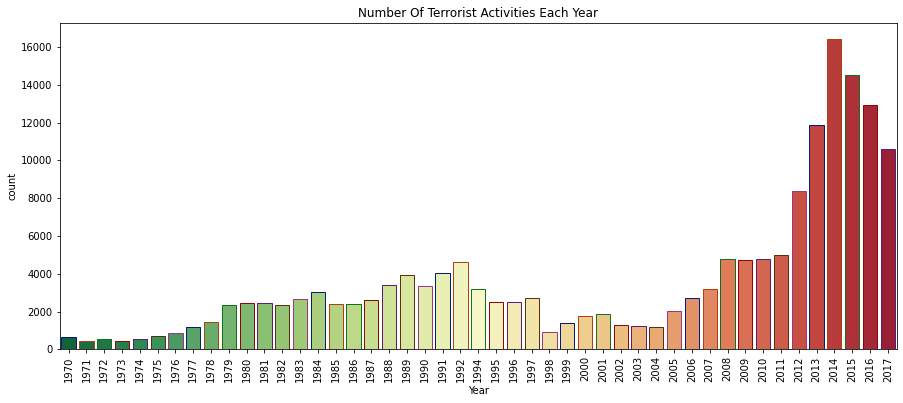

In [53]:
plt.subplots(figsize=(15,6))
sns.countplot('Year',data=Data,palette='RdYlGn_r',edgecolor=sns.color_palette('dark',7))
plt.xticks(rotation=90)
plt.title('Number Of Terrorist Activities Each Year')
plt.show()

**Insights**

- From the above Graph we can clearly see that the Year **2014** is the most Affected Year in the entire Time-Frame.
- The subsequent years are **2015**,**2016** & **2013**.


In [54]:
fig=px.histogram(Data,
                 x='Year',nbins=47,
                 marginal="violin",
                 title="Distribution Curve for the total number of Attacks",
                 text_auto=True,
                 template='plotly_dark')
fig.show()

 **Insights-**
 - The total number of attacks in 2014-2015  crossed **30000** mark in the world wide region.
 
 - From the above Distribution curve it is clearly visible that from the Year around 2009 till 2014-16 the number of terror activities recorded the most.
 
 - Since 2014 onwards there is a gradual decrease in the attacks.
 
 - The Graph clearly depicts a huge spike in the number of attacks post Year 2004.

### Let's check the Top terrorist groups responsible for the most number of attacks around the world within the time frame of 47 years

In [55]:
Terrorrist_group=Data.Group.value_counts()[:20].drop("Unknown")
Terrorrist_group

Taliban                                             7294
Islamic State of Iraq and the Levant (ISIL)         5198
Shining Path (SL)                                   3730
Al-Shabaab                                          3262
New People's Army (NPA)                             2679
Farabundo Marti National Liberation Front (FMLN)    2503
Irish Republican Army (IRA)                         2447
Boko Haram                                          2383
Revolutionary Armed Forces of Colombia (FARC)       2354
Kurdistan Workers' Party (PKK)                      2229
Basque Fatherland and Freedom (ETA)                 1889
Communist Party of India - Maoist (CPI-Maoist)      1844
Maoists                                             1603
Liberation Tigers of Tamil Eelam (LTTE)             1567
National Liberation Army of Colombia (ELN)          1387
Tehrik-i-Taliban Pakistan (TTP)                     1337
Palestinians                                        1106
Houthi extremists (Ansar Allah)

In [56]:
type(Terrorrist_group)

pandas.core.series.Series

/opt/conda/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



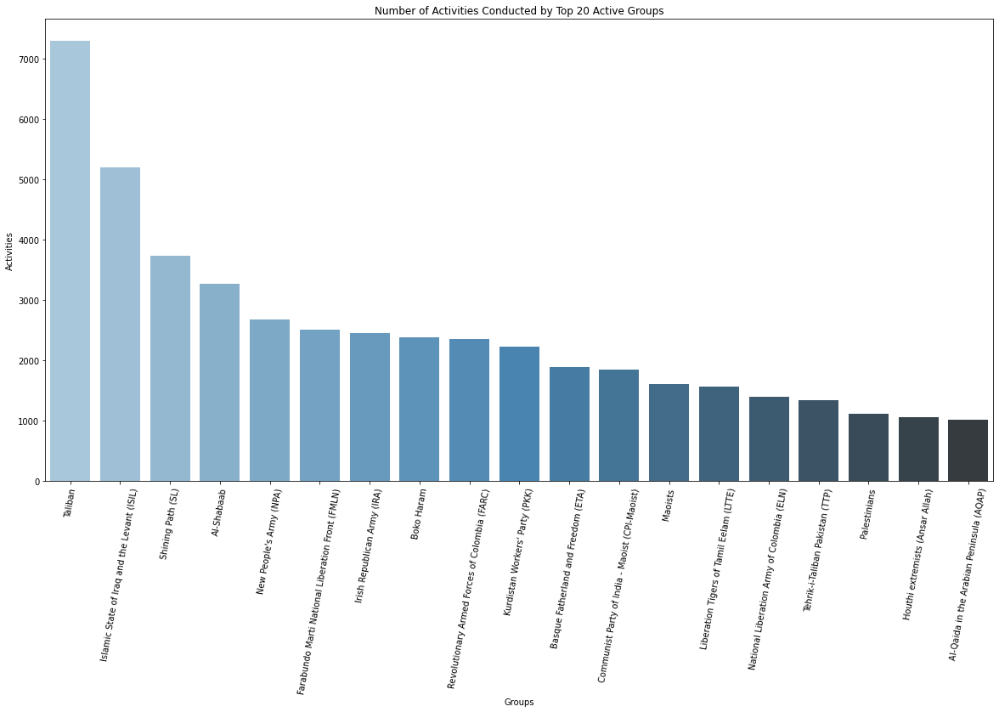

In [57]:
plt.subplots(figsize=(20,10))
plt.xlabel('Groups')
plt.ylabel("Activities")
plt.title("Number of Activities Conducted by Top 20 Active Groups")
plt.xticks(rotation= 80)
sns.barplot(Terrorrist_group.index,Terrorrist_group.values,palette='Blues_d',color='dark')
plt.style.use("dark_background");

In [58]:
fig=px.line(x=Terrorrist_group.index,
            y=Terrorrist_group,
            title="Top 20 Terror-Groups",
            labels={'x':"Terrorist-Groups","y":"Number of Attacks"},
            markers=True,
            template='plotly_dark')
fig.update_yaxes(rangemode='tozero')
fig.show()

**Insights-**
- From the graphs it can easily derived that the most numbers of attacks are conducted by **Taliban** group.
- The graph shows that over 7000 activities has been occurred over the globe which has the direct relation to the **Taliban** Group.
- On the graph we have the Top 20 active terrorist group with the numbers of attack conducted by them through the time frame of our dataset i.e 47 years

### Let's Visulalize the activites conducted in different Regions

In [59]:
Data.Region.unique()

array(['Central America & Caribbean', 'North America', 'South America',
       'Western Europe', 'Eastern Europe', 'Sub-Saharan Africa',
       'Southeast Asia', 'Middle East & North Africa', 'East Asia',
       'Australasia & Oceania', 'South Asia', 'Central Asia'],
      dtype=object)

In [60]:
Data.Region.nunique()

12

In [61]:
Regions=Data.Region.value_counts()
Regions

Middle East & North Africa     48596
South Asia                     43462
Sub-Saharan Africa             17009
South America                  16434
Western Europe                 15009
Southeast Asia                 12037
Central America & Caribbean     8936
Eastern Europe                  5005
North America                   3331
East Asia                        702
Central Asia                     553
Australasia & Oceania            270
Name: Region, dtype: int64


**Here it is visible that there are total 12 Regions within our dataset, let's now try to visualize and get some insights out of it.**


In [62]:
fig= px.area(data_frame= Data,x=Regions.index,y=Regions.values,
             title="Region-Wise Attack Counts",template='plotly_dark',
             #height=900,
             #width=1000,
             #color="Region",
             markers = True,labels={'x':"Regions","y":"Number of Attacks"}
            )
fig.update_yaxes(rangemode="tozero")
fig.show()



**Insights-**
- As per the graphs it is clearly depicted that the Middle-East & North Africa are the most prominent region for the Terrorism.
- In Western Regions like Europe, Central America, Eastern Europe the activities are in lesser numbers.
- The activities in EAST-ASIA, CENTRAL-ASIA region are very few among with Australasia.
- As per the graph only 270 attacks are conducted in the Australasia & Oceania region in comparison of almost 49000 attacks in Middle East & North Africa Region

### Let's Now Analyse the Most Affected Countries

In [63]:
Data.Country.value_counts()

Iraq                   23464
Pakistan               13765
Afghanistan            12501
India                  11558
Colombia                7425
                       ...  
St. Lucia                  1
Antigua and Barbuda        1
Andorra                    1
North Korea                1
Wallis and Futuna          1
Name: Country, Length: 205, dtype: int64

/tmp/ipykernel_503/1773594900.py:1: FutureWarning:

In a future version of pandas all arguments of Series.dropna will be keyword-only



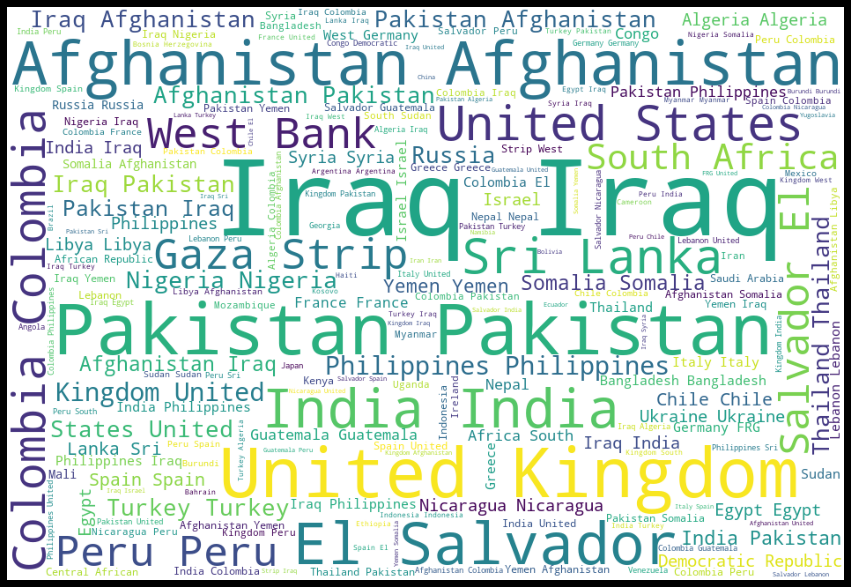

In [64]:
Countries=Data.Country.dropna(False)
plt.subplots(figsize=(15,20))
wordcloud= WordCloud(background_color='white', width=950, height = 650).generate(' '.join(Countries))
plt.axis('off')
plt.imshow(wordcloud)
plt.show();

**Insights-**
- It is clearly visible that **IRAQ** is the most affected nation across the Globe followed by **AFGHANISTAN** &  **PAKISTAN**.
- Very few Activities has been reported from **ISRAEL** & **Russia**.
- **Nigeria**,**Algeria**,**Somalia**, are some of the most affected country from the **South Africa** region.

### Let's check the Top 20 Countries affected by Terrorism

In [65]:
Attacked_country= Data.Country.value_counts()[:20]

In [66]:
Attacked_country

Iraq              23464
Pakistan          13765
Afghanistan       12501
India             11558
Colombia           7425
Philippines        6739
Peru               5006
United Kingdom     4970
El Salvador        4258
Somalia            4108
Turkey             4062
Nigeria            3834
Thailand           3729
Yemen              3305
Spain              3030
Sri Lanka          2898
United States      2763
Algeria            2692
Lebanon            2411
Egypt              2406
Name: Country, dtype: int64

In [67]:
fig =px.bar(Data,
               x=Attacked_country.index,
               y=Attacked_country.values,
               opacity=0.6,
               color=Attacked_country.index,
               labels={'x':'Country','y':"No of Activites"},
               title="Top 20 Affected Countries",
               template='plotly_dark',
               width=900,
               height=400
           )
fig.show()

**Useful Points**
- From the graph we can see that **Pakistan** , **Afghanistan** and **India** are at Top 4 places, that clearly show how much vulnerable these countries are to these activities.
- It is very well Depicted from the Graph that the European Countries has very less number of Occurrences of Terrorist activities as compared to South East Asian Countries.

### Let's visualize the percentage of each type of attack that occurred  across the World geography.

In [68]:
Data['Attack_Type'].unique()

array(['Assassination', 'Armed Assault', 'Bombing/Explosion',
       'Facility/Infrastructure Attack', 'Hijacking', 'Unknown',
       'Hostage Taking (Kidnapping)', 'Unarmed Assault',
       'Hostage Taking (Barricade Incident)'], dtype=object)

In [69]:
type_attack=Data.Attack_Type.value_counts()

In [70]:
type(type_attack)

pandas.core.series.Series

In [71]:
fig =px.pie(Data,
            values=type_attack,
            names=type_attack.index,
            title=" Frequency of Attack Type in World-Wide Region")
fig.show()

- From the Pie chart The Attack-Type - **Bombing** captures around **48%** of the total activities.
- It is almost of the half of the activities that has been conducted all across the world.
- From the Graph we can conclude that the Terror-groups were intently conducting Bombing/Explosions. 
- Armed Assault activities takes about 24% of the total activities.However the **Assassination** activities takes occupies 11% of total activities.

In [72]:
Data.head(2)

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
0,1970,7,2,Dominican Republic,Unknown,Central America & Caribbean,Assassination,Julio Guzman,1.0,0.0,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,NaN,-69.951164,18.456792
5,1970,1,1,United States,Illinois,North America,Armed Assault,Cairo Police Headquarters,0.0,0.0,1/1/1970: Unknown African American assailants ...,Black Nationalists,Police,Firearms,To protest the Cairo Illinois Police Deparment,NaN,-89.176269,37.005105



**Let's take the account of total casualties and add it up as a separate column on the dataset**

In [73]:
Data["Casualties"]= Data["Wounded"]+Data["Killed"]

**Here we have added another column "CASUALITIES" to the dataset.**

In [74]:
Data.shape

(171344, 19)

In [75]:
Data.Casualties

0         1.0
5         0.0
6         0.0
7         0.0
8         0.0
         ... 
181686    3.0
181687    9.0
181688    0.0
181689    0.0
181690    0.0
Name: Casualties, Length: 171344, dtype: float64

## Ask & Answer

### Q1- Find out the Total number of casualties recorded for the **MOST AFFECTED YEAR** by different Weapon Types

In [76]:
Most_Affected_Year=df["Year"].value_counts().idxmax()
Most_Affected_Year

2014

**Here we found out 2014 as the most affected Year, we will now use the query method to limit our dataset only to the year 2014**

In [77]:
fig = px.scatter(Data.query("Year==2014"),
                 title="Distribution for the Casualties across the Regions",
                 x="Casualties",
                 y="Region",
                 color="Region",
                 hover_name="Country",
                 animation_frame= "Weapon_type",template="plotly_dark",
                 #width=1000,
                 #height=550,
                 log_x=True
                )
fig.show()

From - https://blogs.sas.com/content/iml/2014/07/09/scatter-plots-with-log-axes.html 


**If you are trying to visualize numerical data that range over several magnitudes, conventional wisdom says that a log transformation of the data can often result in a better visualization**

- From the graph above, it is clearly depicted- as we move forward with the Animation, the most casualties are caused by **Explosions/ Bombing** activities.
- As we see the clusters, we can say that the average number of casualties per explosive activity would be in range of 20 to 100 respective to the regions.
- In the Central Asia Region (CHINA) there are very small number of casualties rarely 2 or 3 casualties occurred by **Bombing/Explosion**, and hardly any on the other activities.

### Q2- What are the total number of Casualties  and Deaths recorded for each Region and Country

In [78]:
Regionwise_Casulaties=Data[["Region","Casualties"]].groupby("Region").sum().sort_values(by="Casualties",ascending=False)

In [79]:
Regionwise_Casulaties

,Casualties
Region,
Middle East & North Africa,349858.0
South Asia,240294.0
Sub-Saharan Africa,129887.0
South America,44209.0
Southeast Asia,41379.0
Central America & Caribbean,37385.0
North America,26277.0
Western Europe,24747.0
Eastern Europe,19421.0


In [80]:
fig = px.sunburst(Data, path=['Region', 'Country'], 
                  values='Casualties',
                  title="REGION WISE CASULATIES COUNT",color_continuous_scale="inferno",
                  #template="plotly_dark",
                  width=900,
                  height=650
                )
fig.show()

- For the region wise Casualties it is accounted that the total number of Middle East & North Africa Region has **349,800**.
- It is observable from th Sunburst that the alone **Iraq** has the somewhat near the number of casualties as of the entire **South Asia Region**.
- For the **South Asia Region** the number drop down to **240,283** which is around **100k** lesser than Middle East Region casualties count.

- **North America Region** only has **26,277** casualties in which **United States** holds the majority portion with **24,467** casualties.


In [81]:
RegionWise_Killed=Data[["Region","Killed"]].groupby("Region").sum().sort_values(by="Killed",ascending=False)
RegionWise_Killed

,Killed
Region,
Middle East & North Africa,136478.0
South Asia,100204.0
Sub-Saharan Africa,77557.0
Central America & Caribbean,28465.0
South America,27740.0
Southeast Asia,15473.0
Eastern Europe,7400.0
Western Europe,6662.0
North America,4827.0


In [82]:
Total=RegionWise_Killed.sum()
Total

Killed    407087.0
dtype: float64

In [83]:
plotly_colorscales = px.colors.named_colorscales()
print(plotly_colorscales)

['aggrnyl', 'agsunset', 'blackbody', 'bluered', 'blues', 'blugrn', 'bluyl', 'brwnyl', 'bugn', 'bupu', 'burg', 'burgyl', 'cividis', 'darkmint', 'electric', 'emrld', 'gnbu', 'greens', 'greys', 'hot', 'inferno', 'jet', 'magenta', 'magma', 'mint', 'orrd', 'oranges', 'oryel', 'peach', 'pinkyl', 'plasma', 'plotly3', 'pubu', 'pubugn', 'purd', 'purp', 'purples', 'purpor', 'rainbow', 'rdbu', 'rdpu', 'redor', 'reds', 'sunset', 'sunsetdark', 'teal', 'tealgrn', 'turbo', 'viridis', 'ylgn', 'ylgnbu', 'ylorbr', 'ylorrd', 'algae', 'amp', 'deep', 'dense', 'gray', 'haline', 'ice', 'matter', 'solar', 'speed', 'tempo', 'thermal', 'turbid', 'armyrose', 'brbg', 'earth', 'fall', 'geyser', 'prgn', 'piyg', 'picnic', 'portland', 'puor', 'rdgy', 'rdylbu', 'rdylgn', 'spectral', 'tealrose', 'temps', 'tropic', 'balance', 'curl', 'delta', 'oxy', 'edge', 'hsv', 'icefire', 'phase', 'twilight', 'mrybm', 'mygbm']


In [84]:
Percentage_count_iraq=((Total-136446.0)/Total)*100
Percentage_count_iraq

Killed    66.482349
dtype: float64

In [85]:
fig = px.treemap(Data, path=['Region', 'Country'], values='Killed',
                 title="Region & Countrywise Death Toll",
                 #template="plotly_dark",
                 color="Region",
                 color_continuous_scale='earth'
                                 
                )
fig.show()

- On analyzing the Tree-MAP, we found out that **66%** of the total deaths tolls are accountable to one country which is **IRAQ**.
- Within the region as well Iraq accounts for around **40%** of the total deaths recorded. 
- The reason for the high number of death Toll for Iraq is due to the **8 year long war with Iran** & **US Invasion**. 

### Q3- What is the Relation between the type of Attack and the number of Deaths caused by each of them Year wise.

In [158]:
fig=px.histogram(Data,x="Attack_Type",y="Killed",
                 title =" Year- Wise Trends on the Weapons Usage and number of Deaths ",
                 animation_frame=Data['Year'],
                 width=1000,
                 height=800,
                 template='plotly_dark'
                )
fig.update_yaxes(range = [0,1000])
fig.show()

- From the graph we can clearly see that the **Bombing/Explosion** activities has a major impact on the number of deaths reported.

- **Bombing/Explosion** & **Assassination** activities keeps on increasing  which can be seen as we move forward in the graphical animation.

- The Increase in **Assassination** activities within a particular region or country is an alarming signs that needs to be taken care of.




### Q4- Calculate the rate of increase in the Terrorist Activities within the time frame of the dataset

In [87]:
Year=Data.Year.value_counts().to_dict()
rate=((Year[2017]-Year[1970])/Year[2017])*100
print(Year[1970],'attacks happened in 1970 &',Year[2017],'attacks happened in 2017')
print('So the number of attacks from 1970 has increased by',np.round(rate,0),'% till 2017')

628 attacks happened in 1970 & 10621 attacks happened in 2017
So the number of attacks from 1970 has increased by 94.0 % till 2017


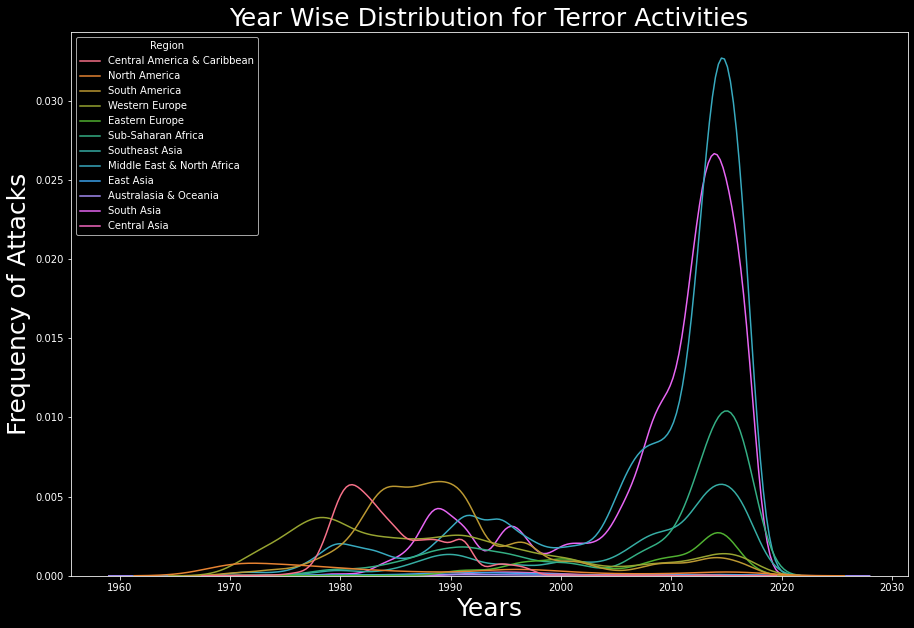

In [88]:
plt.figure(figsize=(15,10))
sns.kdeplot(Data['Year'], 
            hue =Data['Region']
           )
plt.title('Year Wise Distribution for Terror Activities',fontsize=25)
plt.xlabel("Years",fontsize=25)
plt.ylabel("Frequency of Attacks",fontsize=25)
plt.show();


**Insights**
- There is a great spike in the number of attacks recorded from the year 1970 till 2017, the total number of increase in rate is **94%** which is a very alarming.

-  The Graph clearly depicts a huge spike in the number of attacks post Year 2000 for most of the Regions.

- There are Specific Regions which are the Most affected & the the difference between the numbers of activities are quite large with respect to the other Regions.

### Q5- Calculate the total number of attacks in each country

**Let's use the choropleth Visulation to better understand the total number of attacks for each country**

**We will first create a new dataframe which contains the total count of attacks for each country in order to use it as a colour bar.**

In [89]:
terror=Data.groupby(['Country'],as_index=False).count()

In [90]:
terror

,Country,Year,Month,Day,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude,Casualties
0,Afghanistan,12501,12501,12501,12501,12501,12501,12501,12501,12501,12392,12501,12501,12501,3541,5382,12410,12410,12501
1,Albania,80,80,80,80,80,80,80,80,80,25,80,80,80,17,5,79,79,80
2,Algeria,2692,2692,2692,2692,2692,2692,2692,2692,2692,1581,2692,2692,2692,1476,986,2569,2569,2692
3,Andorra,1,1,1,1,1,1,1,1,1,0,1,1,1,0,0,0,0,1
4,Angola,335,335,335,335,335,335,335,335,335,131,335,335,335,125,54,304,304,335
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,Yemen,3305,3305,3305,3305,3305,3305,3305,3305,3305,3223,3305,3305,3305,715,1023,3229,3229,3305
201,Yugoslavia,192,192,192,192,192,192,192,192,192,106,192,192,192,106,36,191,191,192
202,Zaire,47,47,47,47,47,47,47,47,47,1,47,47,47,0,0,41,41,47
203,Zambia,56,56,56,56,56,56,56,56,56,12,56,56,56,11,1,48,48,56


In [91]:
fig=px.choropleth(terror,
                  locations='Country',
                  #locationmode="Country",
                  color='Year',
                  hover_name='Country',
                  projection='orthographic',
                  title='Frequency of Number of Attacks (1970-2017)',
                  labels={'Year':'Attacks'}
                 )
fig.show()

**Insights**-

- From the World Geography it is clearly visible that South Asia is has the most number of attacks in respect to the other regions.
- The average number of attacks in the South Asian Countries would be in th range 15k to 18k, which is very high number in respect to the other regions.

### Q6- What are the Worst Terror Attacks in the history causing the most casualties? 

In [92]:
trr1 = Data.sort_values(by='Casualties',ascending=False)[:50]

heat=trr1.pivot_table(index='Country',columns='Year',values="Casualties")

heat.fillna(0,inplace=True)
colorscale = [[0, '#edf8fb'], [.3, '#00BFFF'],  [.6, '#8856a7'],  [1, '#810f7c']]
heatmap = go.Heatmap(z=heat.values, x=heat.columns, y=heat.index,colorscale=colorscale)
data = [heatmap]
layout = go.Layout(
    title='Top 50 Worst Terror Attacks in History from 1982 to 2016')
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='heatmap',show_link=False)

- From the above Heat-Map, we can clearly see the **United States** is the victim of the worst attack casuing around **9600** Casualties for a single attack which was in the year **2001**.
- In year **1998** Kenya has the worst attack causing **4000** casualties.
- We have another country **JAPAN** with over **3000** casualties in **1995**
- India has the worst attack in year **2006** which caused  **1000* casualties.

### Q7- What is the relation between the Targets being attacked with respect to the Region?

In [119]:
Data.head(2)

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude,Casualties
0,1970,7,2,Dominican Republic,Unknown,Central America & Caribbean,Assassination,Julio Guzman,1.0,0.0,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,NaN,-69.951164,18.456792,1.0
5,1970,1,1,United States,Illinois,North America,Armed Assault,Cairo Police Headquarters,0.0,0.0,1/1/1970: Unknown African American assailants ...,Black Nationalists,Police,Firearms,To protest the Cairo Illinois Police Deparment,NaN,-89.176269,37.005105,0.0


In [144]:
fig = px.sunburst(Data, 
                  path=['Target_type','Region'], 
                  values='Killed',
                  title="Region-Wise Targets Attacked",color_continuous_scale="sunset",
                  #template="plotly_dark",
                  width=900,
                  height=650
                )
fig.show()

**Insights**
- From the above graph it is clearly depicted that **Private Citizens & Property** are most commonly attacked Worldwide.
- **Military & Police Personnels** are the second and third most Targets types of the global terrorist activities.

### Q8- What are the top most Affected States of INDIA?

In [97]:
India_DF= Data[(Data.Country=="India")]

In [94]:
India_DF

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude,Casualties
1186,1972,2,22,India,Delhi,South Asia,Hijacking,B-747,0.0,0.0,NaN,Palestinians,Airports & Aircraft,Explosives,NaN,NaN,77.153336,28.585836,0.0
2764,1975,1,2,India,Bihar,South Asia,Bombing/Explosion,Lalit Narayan Mishra and a legislator,4.0,0.0,"1/2/1975: The Indian Railway Minister, Lalit N...",Ananda Marga,Government (General),Explosives,Unknown,The attack occurred in the town,85.781004,25.863042,4.0
3857,1976,5,26,India,Delhi,South Asia,Bombing/Explosion,New Delhi airport,0.0,0.0,NaN,Unknown,Airports & Aircraft,Explosives,NaN,NaN,77.153336,28.585836,0.0
5327,1977,9,28,India,Maharashtra,South Asia,Hijacking,DC-8,0.0,0.0,NaN,Japanese Red Army (JRA),Airports & Aircraft,Firearms,NaN,NaN,72.877656,19.075984,0.0
7337,1979,1,13,India,Assam,South Asia,Armed Assault,patrol,0.0,0.0,NaN,Naga People,Police,Firearms,NaN,NaN,92.937574,26.200605,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181663,2017,12,30,India,Kerala,South Asia,Bombing/Explosion,Koothuparamba Police Station,0.0,0.0,12/30/2017: Assailants threw an explosive devi...,Unknown,Police,Explosives,"The specific motive is unknown; however, sourc...",The incident occurred in the Kannur district.,75.565432,11.831902,0.0
181665,2017,12,30,India,Chhattisgarh,South Asia,Facility/Infrastructure Attack,Road Construction Site,0.0,0.0,12/30/2017: Assailants set fire to seven vehic...,Communist Party of India - Maoist (CPI-Maoist),Business,Firearms,"The specific motive is unknown; however, sourc...",The incident occurred in the Dantewada district.,81.497666,18.802725,0.0
181672,2017,12,31,India,Jammu and Kashmir,South Asia,Armed Assault,Camp,8.0,3.0,12/31/2017: Assailants armed with grenades and...,Jaish-e-Mohammad (JeM),Police,Explosives,"The specific motive is unknown; however, sourc...",The incident occurred in the Pulwama district.,74.964225,33.966527,11.0
181684,2017,12,31,India,Assam,South Asia,Hostage Taking (Kidnapping),Personal Security Officer of Council Member Ih...,0.0,0.0,12/31/2017: Assailants abducted Prafulla Phuka...,Zeliangrong United Front,Government (General),Firearms,NaN,The incident occurred in the Dima Hasao distri...,93.015788,25.180162,0.0


/tmp/ipykernel_503/4144581368.py:1: FutureWarning:

In a future version of pandas all arguments of Series.dropna will be keyword-only



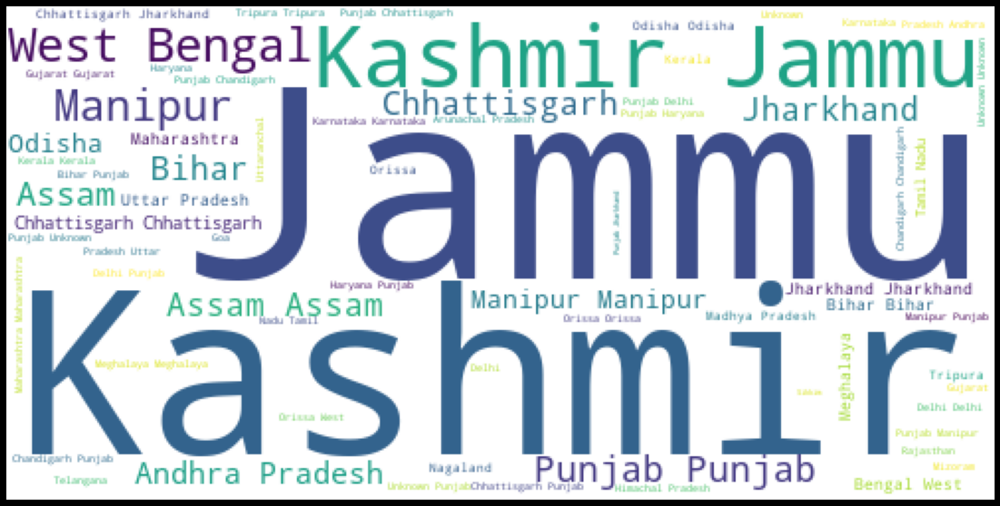

In [150]:
cities=India_DF.State.dropna(False)

plt.subplots(figsize=(20,10))
wordcloud= WordCloud(background_color='white', width=500, height = 250).generate(' '.join(cities))
plt.axis('off')
plt.imshow(wordcloud)
plt.show();

In [155]:
cities.value_counts()

Jammu and Kashmir    2347
Assam                1089
Manipur              1089
Chhattisgarh          971
Jharkhand             871
Punjab                859
Bihar                 677
West Bengal           634
Odisha                412
Maharashtra           302
Meghalaya             293
Andhra Pradesh        246
Orissa                219
Uttar Pradesh         199
Delhi                 198
Unknown               154
Tamil Nadu            147
Tripura               116
Nagaland              114
Kerala                 96
Madhya Pradesh         75
Karnataka              71
Gujarat                70
Haryana                49
Chandigarh             46
Andhra pradesh         41
Rajasthan              40
Mizoram                27
Uttaranchal            24
Arunachal Pradesh      24
Telangana              24
Himachal Pradesh       23
Goa                     5
Sikkim                  4
Puducherry              2
Name: State, dtype: int64

**Insights**
- The above Word Cloud suggest the top 3 most attacked cities in INDIA are **Jammu & Kashmir**,**Assam**,**Manipur**.
- It is clearly depicted that the **North India** region is more vulnerable to the terrorist activities, one contributing factor for it is that the North Indian region especially **Parts of Kashmir**, **Punjab** & **Rajasthan** share borders with the neighboring country **Pakistan**.
- There are only few of the activities in **Puducherry**,**Sikkim** & **Goa**


## Summary and Conclusion


In the above project, we discovered some meaningful insights regarding the Global Terrorism activities. We have explored the dataset downloaded from  Kaggle and laid out graphical interpolation about the trends of the top affected countries, regions, most active Terror groups, derived by the activities.

From the insights we can now conclude that the Global Terrorism activities are appreciably affecting only some of the Region where these activities are mostly occurred by the prominent Terror Groups.  

**FUTURE Scopes** - 

We can select different country or a Regions and perform deep analysis for the Terrorism activities trends and can prepare a report mentioning the difference between the respective countries or Regions.